In [1]:
import numpy as np
import matplotlib.pylab as plt
import pandas as pd
from ipywidgets import interactive
import numpy as np
import matplotlib.pylab as plt
import pandas as pd
from ipywidgets import interactive
from scipy.fftpack import fft, ifft,ifftshift,fftshift
from IPython.display import display, HTML
from scipy.linalg import circulant
from scipy.linalg import toeplitz, hankel
from IPython.display import clear_output
from scipy.linalg import expm
import pickle
from matplotlib import colors


#### --------- Definition of variables ------------------------

N_size=50001 #
Gamma=0.5
Lambda=0.5
num_data=2000
#### ------------------------------------------------------------
def Fermi_dirac(beta,mu,n,Gamma=Gamma,Lambda=Lambda,N=N_size):
    # beta is the inverse thermic energy associated in the system (beta)
    # mu corresponds to the chemical potential
    # n is the position of the particle
    # f=np.exp(T*(Omega(Gamma,Lambda,2.0*(np.pi/N)*n)-mu)) +1
    # N corresponds to the size of the system
    f=np.exp(beta*(Omega(Gamma,Lambda,((2.*np.pi)/float(N)) * n)-mu)) +1
    return 1/f


display(HTML("""
<style>
.output {
    display: flex;
    align-items: left;
    text-align: center;
}
</style>
"""))

def Alpha(Gamma,Lambda,theta):
    return Lambda+np.cos(theta)
def Beta(Gamma,Lambda,theta):
    return Gamma*np.sin(theta)
def Omega(Gamma,Lambda,theta):
    return np.sqrt(Alpha(Gamma,Lambda,theta)**2 + Beta(Gamma,Lambda,theta)**2 )
def Phi(Gamma,Lambda,theta):
    return np.arctan2(Beta(Gamma,Lambda,theta),Alpha(Gamma,Lambda,theta))


def Get_Bands_Matrix(N_size,Gamma=Gamma,Lambda=Lambda,beta=0.40824,mu=0,Ground =False):
    if Ground:
        x=np.arange(0,(N_size-1)/2+ 1)
        m_cos=[-0.5 for i in x]
        m_sin=[-0.5 for i in x]
        x=np.arange(-(N_size-1)/2,(N_size-1)/2+1)
        M_minous=[((m_cos[np.abs(int(i))]-m_sin[np.abs(int(i))])*0.5*np.exp(1.j*np.sign((2.0*np.pi/N_size) * i)*Phi(Gamma,Lambda,np.abs((2.0*np.pi/N_size) * i)))) for i in x]
        M_plus = [((m_cos[np.abs(int(i))]+m_sin[np.abs(int(i))])*0.5*np.exp(1.j*np.sign((2.0*np.pi/N_size) * i)*Phi(Gamma,Lambda,np.abs((2.0*np.pi/N_size) * i)))) for i in x]
        Mminousband=np.array(M_minous)
        Mplusband=np.array(M_plus)
        
    else:
        x=np.arange(0,(N_size-1)/2+ 1)
        m_cos=[-0.5 if np.random.random()>Fermi_dirac(beta,mu,n=i) else 0.5 for i in x]
        m_sin=[-0.5 if np.random.random()>Fermi_dirac(beta,mu,n=i) else 0.5 for i in x]
        x=np.arange(-(N_size-1)/2,(N_size-1)/2+1)

        M_minous=[((m_cos[np.abs(int(i))]-m_sin[np.abs(int(i))])*0.5*np.exp(1.j*np.sign((2.0*np.pi/N_size) * i)*Phi(Gamma,Lambda,np.abs((2.0*np.pi/N_size) * i)))) for i in x]
        M_plus = [((m_cos[np.abs(int(i))]+m_sin[np.abs(int(i))])*0.5*np.exp(1.j*np.sign((2.0*np.pi/N_size) * i)*Phi(Gamma,Lambda,np.abs((2.0*np.pi/N_size) * i)))) for i in x]
        Mminousband=np.array(M_minous)
        Mplusband=np.array(M_plus)
        
    x=np.arange(-(N_size-1)/2,(N_size-1)/2+ 1)
    Fourier_plus=fft(ifftshift(Mplusband))
    Fourier_minous=fft(ifftshift(Mminousband))
    return Fourier_plus/N_size,Fourier_minous/N_size

def Toeplitz_matrix(Fourier_plus,L):
    First_column = Fourier_plus[:L]
    First_row = np.roll(Fourier_plus,-1)[::-1][:L]
    return toeplitz(First_column,First_row)
def Hankel_matrix(Fourier_minous,L):
    to_use=Fourier_minous[:2*L-1]
    First_column=to_use[:L]
    Last_row=np.roll(to_use,-L+1)[:L]
    return hankel(First_column,Last_row)

def Covariance_matrix(L,Gamma=Gamma,Lambda=Lambda,beta=0.40824,mu=0,N_size=N_size,Ground=False):
    if Ground:
        Fourier_plus,Fourier_minous=Get_Bands_Matrix(Gamma=Gamma,Lambda=Lambda,N_size=N_size,beta=beta,mu=mu,Ground=True)
    else:
        Fourier_plus,Fourier_minous=Get_Bands_Matrix(Gamma=Gamma,Lambda=Lambda,N_size=N_size,beta=beta,mu=mu,Ground=False)
    return (Toeplitz_matrix(Fourier_plus,L)+Hankel_matrix(Fourier_minous,L))

def Covariance_matrix_from_sub_sample(Fourier_plus,Fourier_minous,L):
    return (Toeplitz_matrix(Fourier_plus,L)+Hankel_matrix(Fourier_minous,L))


def print_progress(total,step,num=50):
    message="["+"="*int(num*((step/total)))+" "*int(num*(1-(step/total)))+"]"
    message+="  "+str(round(step/total*100,3))+ " "+ "%"
    print(message,end="\r")
    
def get_band_of_matrix(Matrix,num_band):
    L,C=Matrix.shape
    if L!=C:
        raise ValueError("Only squared matrix can be computed")
    if num_band > 0:
        return np.array([[Matrix[i,j] for i in range(num_band,L) if i-j == num_band] for j in range(L-num_band)]).reshape(L-num_band)
    elif num_band <0:
        return np.array([[Matrix[i,j] for i in range(L) if i-j == num_band] for j in range(-num_band,L)]).reshape(L+num_band)
    else:
        return np.diagonal(Matrix)

In [2]:
with open('../Calculating_Entropy_and_density_matrix/data_50k.pkl', 'rb') as File:
    Data=pickle.load(File)

In [3]:
F_plus,F_minous=Data[:,:,0],Data[:,:,1]
F_plus_avg,F_minous_avg=Data[:,:,0].mean(axis=0),Data[:,:,1].mean(axis=0)


In [4]:
L=81
Cov_matrix=Covariance_matrix_from_sub_sample(F_plus_avg,F_minous_avg,L)
O_1_avg,S_avg,O_2_avg=np.linalg.svd(Cov_matrix)


In [5]:
L=81
Cov_matrix=Covariance_matrix_from_sub_sample(F_plus[1,:],F_minous[1,:],L)
O_1,S,O_2=np.linalg.svd(Cov_matrix)


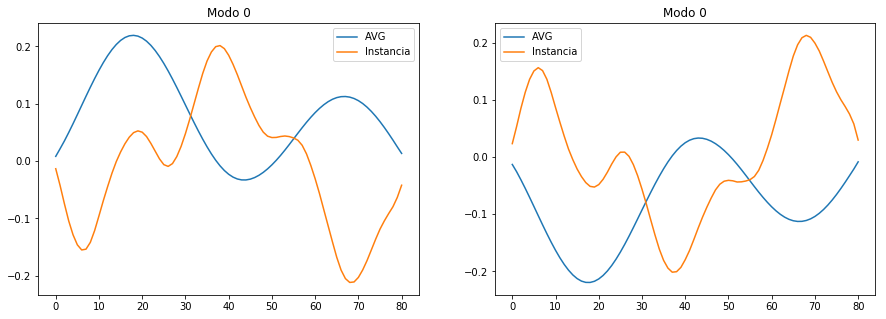

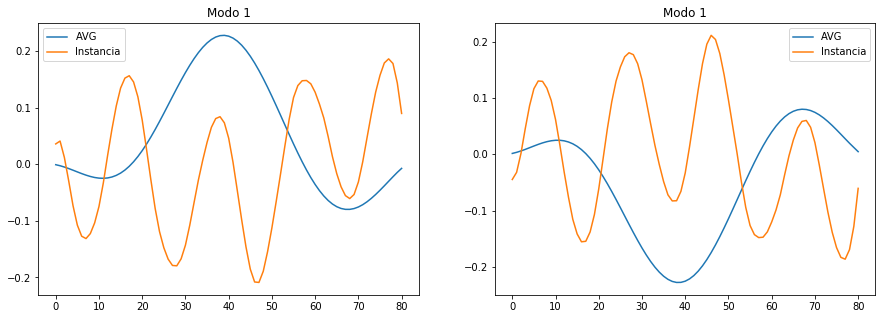

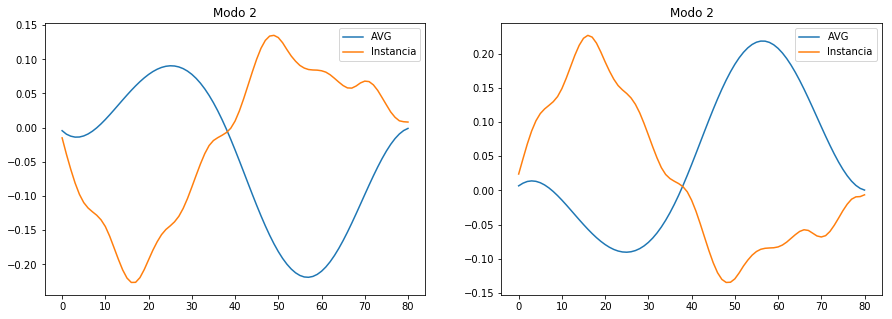

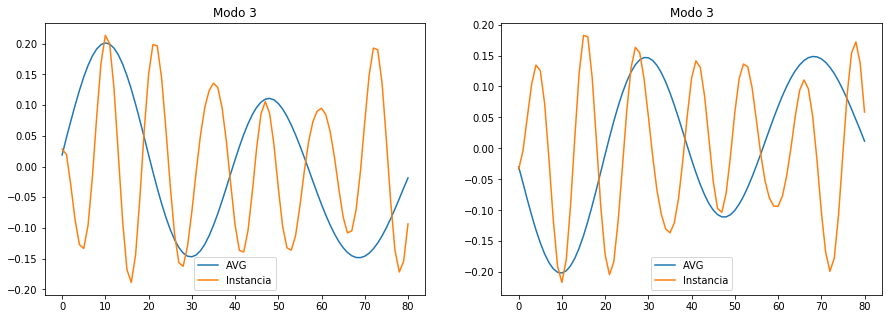

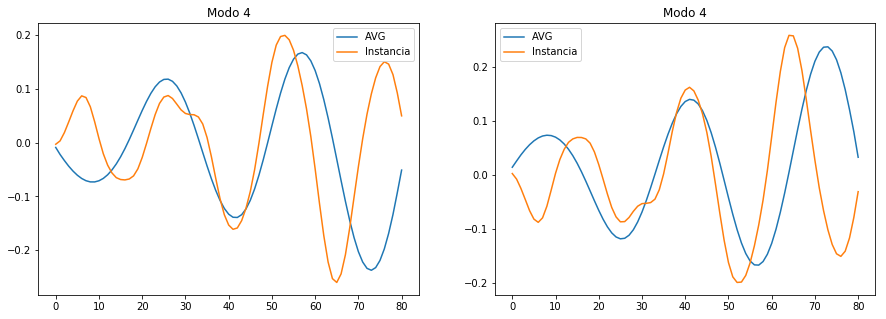

...

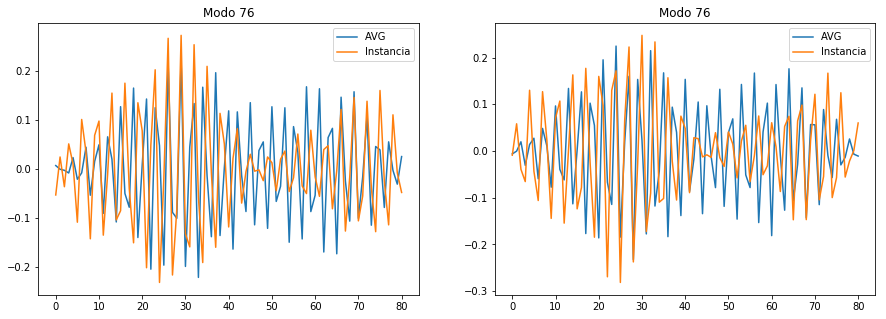

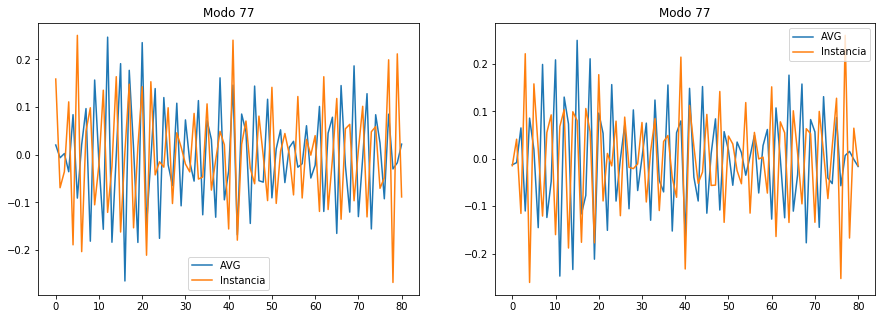

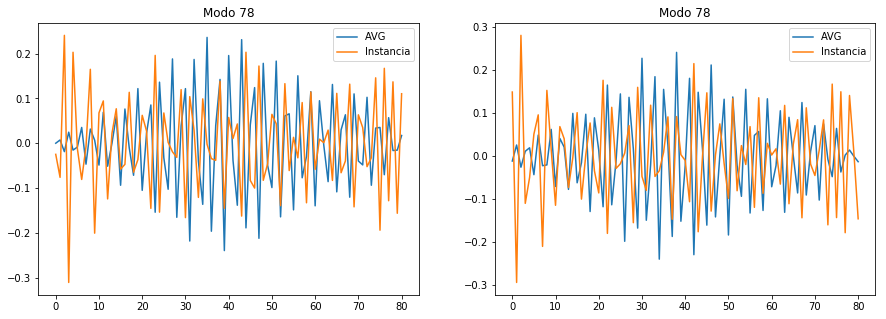

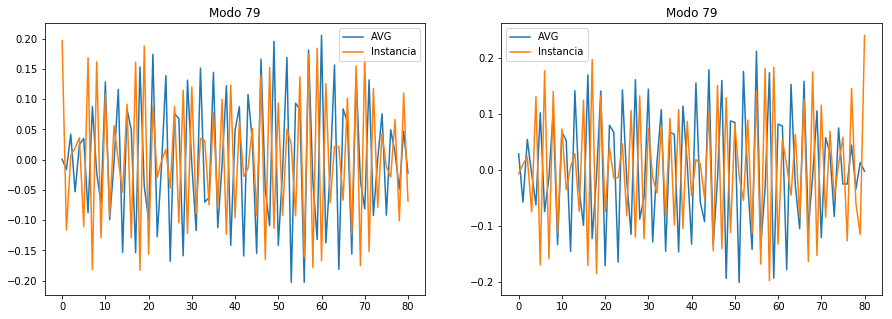

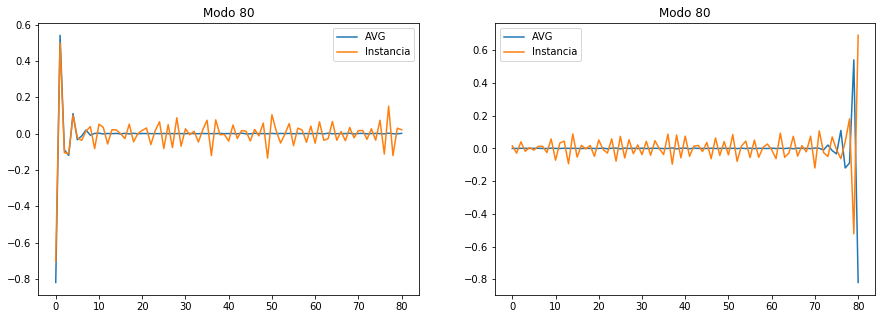

In [6]:
for i in range(O_1.shape[0]):
    plt.figure(figsize=(15,5))
    plt.subplot(1,2,1)
    plt.title("Modo {}".format(i))
    plt.plot(O_1_avg[:,i],label="AVG")
    plt.plot(O_1[:,i],label="Instancia")
    plt.legend()
    plt.subplot(1,2,2)
    plt.title("Modo {}".format(i))
    plt.plot(O_2_avg[i,:],label="AVG")
    plt.plot(O_2[i,:],label="Instancia")
    plt.legend()
    plt.show()

In [7]:
Cov_matrix=Covariance_matrix_from_sub_sample(F_plus[0,:],F_minous[0,:],L)
O_1_T,S,O_2_T=np.linalg.svd(Cov_matrix)
for i in range(1,F_minous.shape[0]):
    Cov_matrix=Covariance_matrix_from_sub_sample(F_plus[i,:],F_minous[i,:],L)
    O_1,S,O_2=np.linalg.svd(Cov_matrix)
    O_1_T+=O_1/F_minous.shape[0]
    O_2_T+=O_2/F_minous.shape[0]

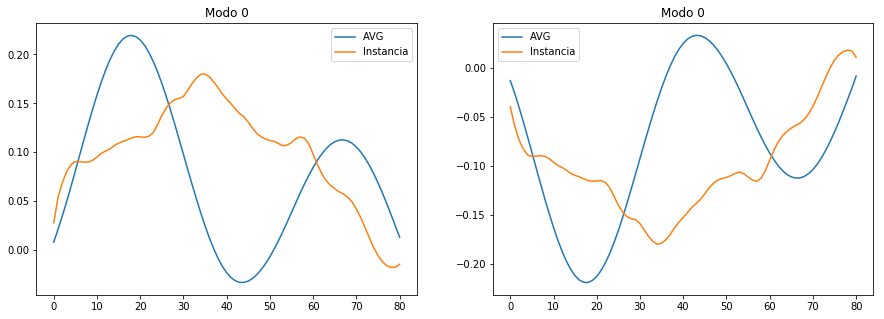

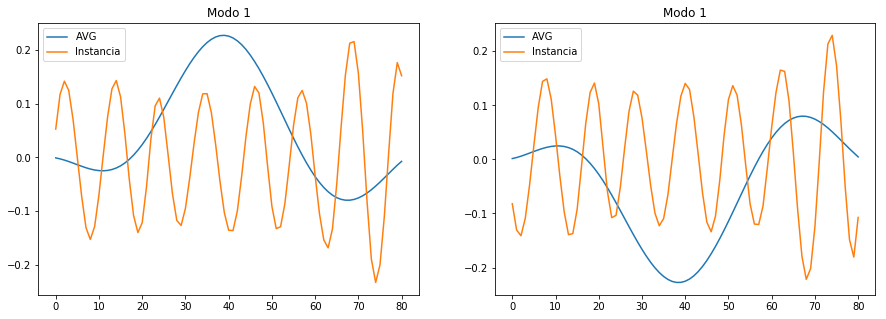

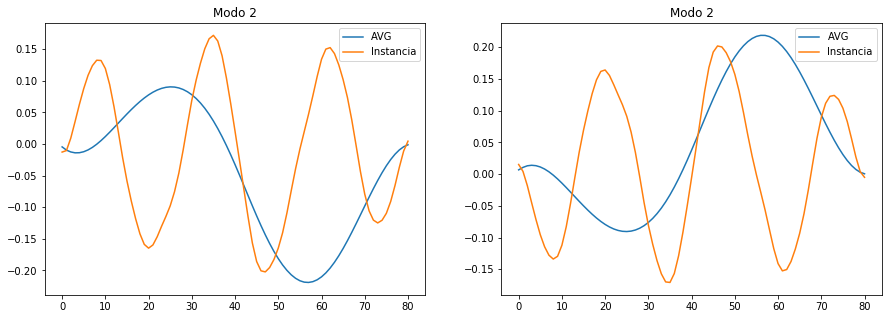

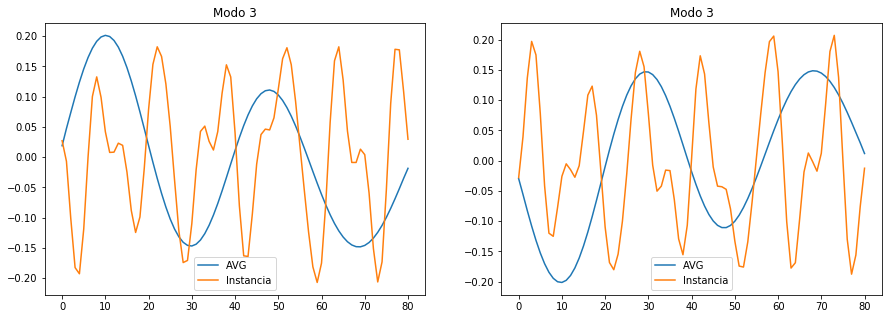

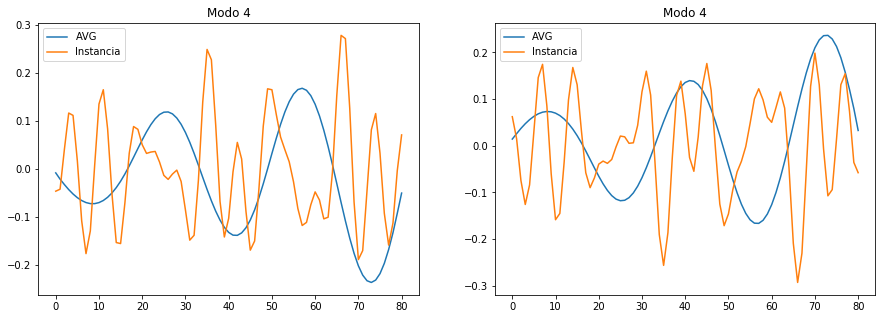

...

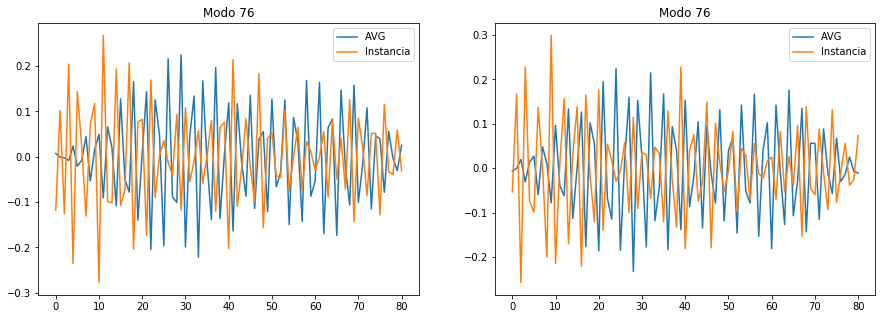

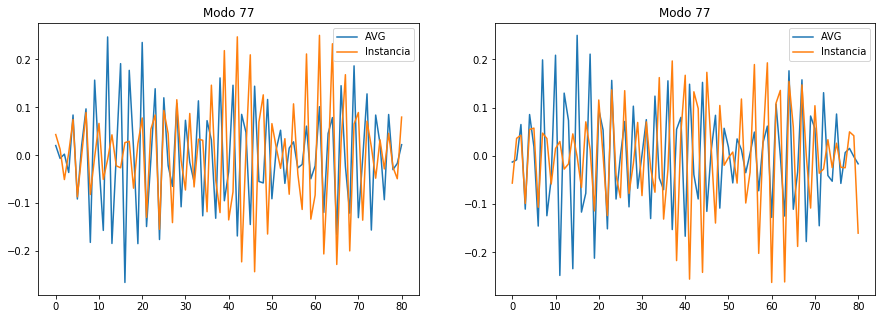

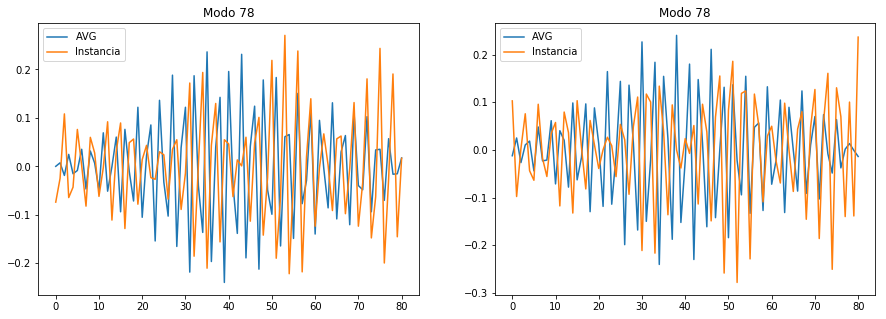

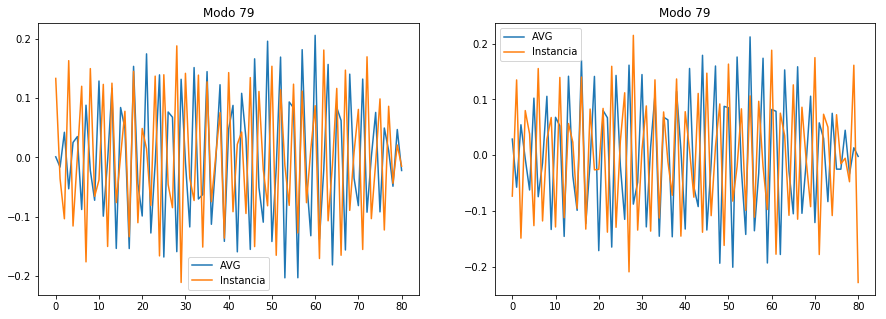

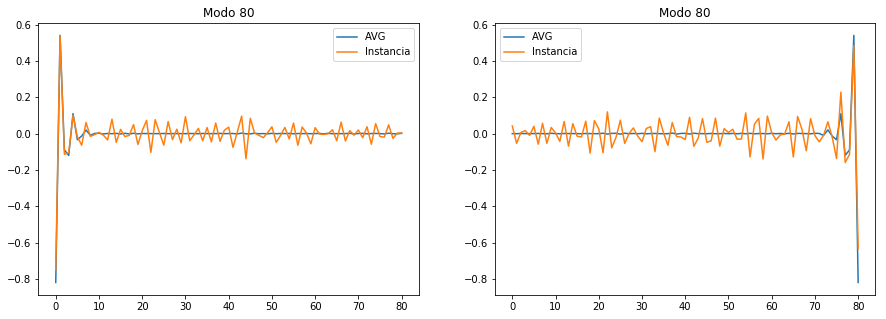

In [8]:
for i in range(O_1.shape[0]):
    plt.figure(figsize=(15,5))
    plt.subplot(1,2,1)
    plt.title("Modo {}".format(i))
    plt.plot(O_1_avg[:,i],label="AVG")
    plt.plot(O_1_T[:,i],label="Instancia")
    plt.legend()
    plt.subplot(1,2,2)
    plt.title("Modo {}".format(i))
    plt.plot(O_2_avg[i,:],label="AVG")
    plt.plot(O_2_T[i,:],label="Instancia")
    plt.legend()
    plt.show()

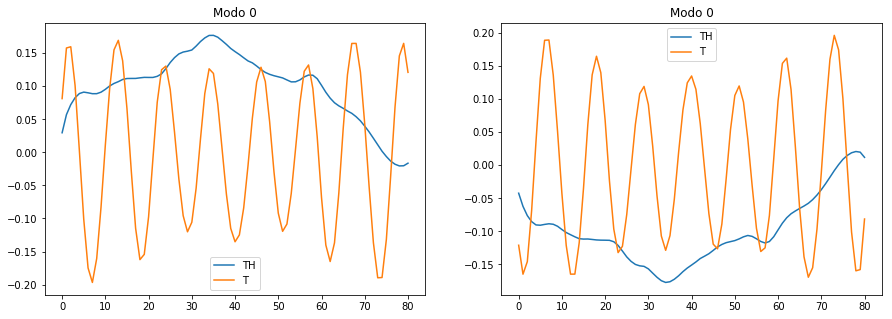

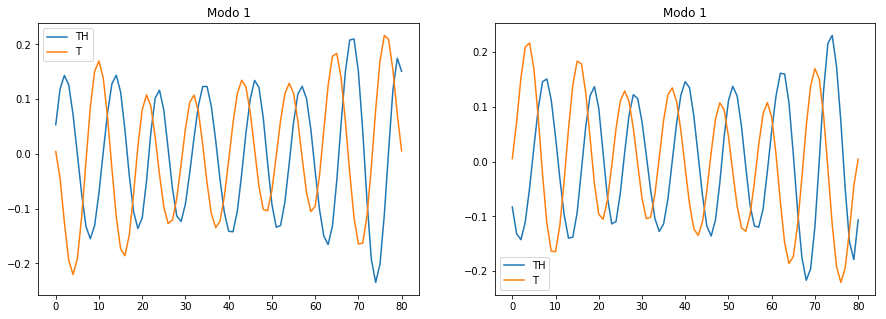

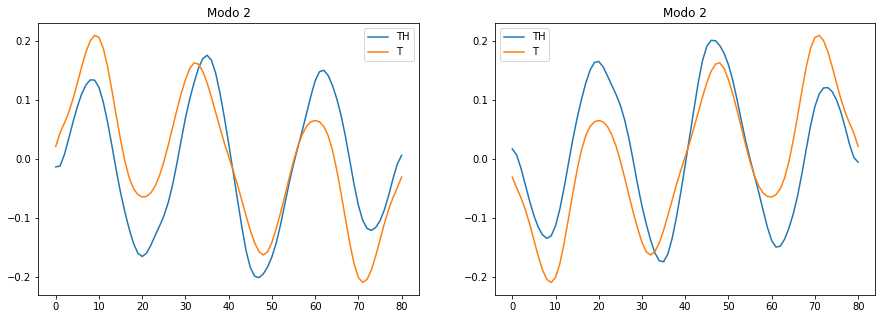

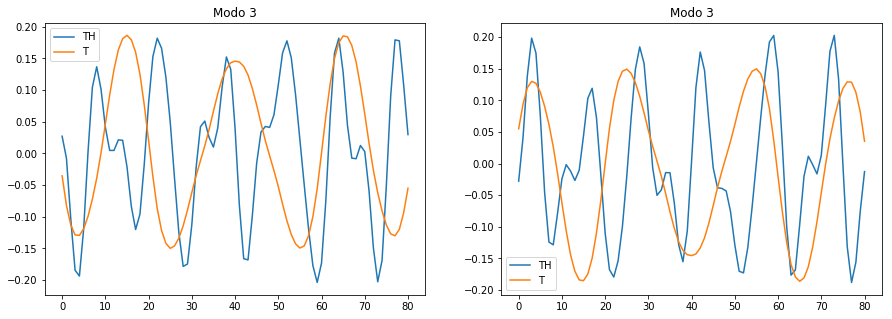

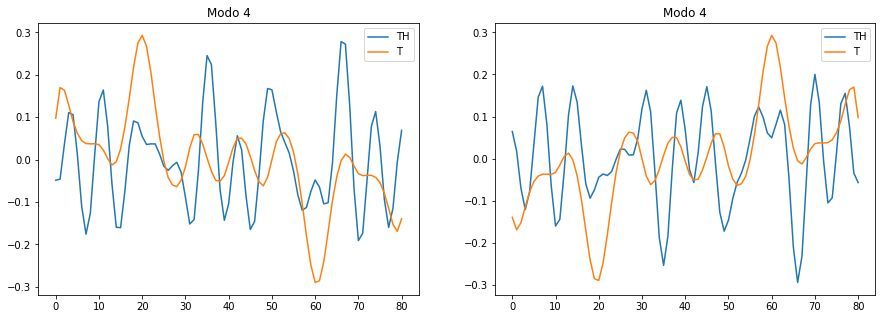

...

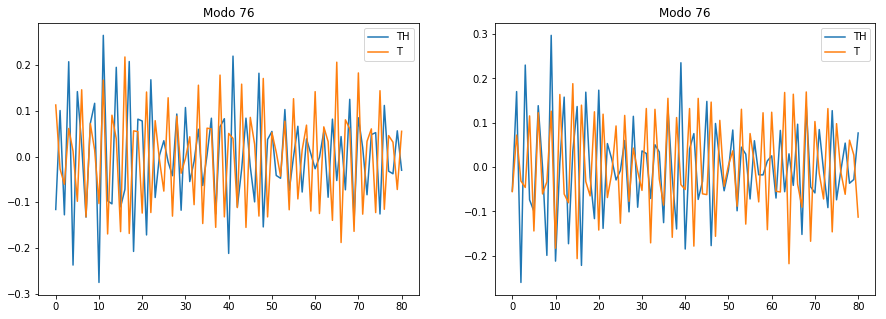

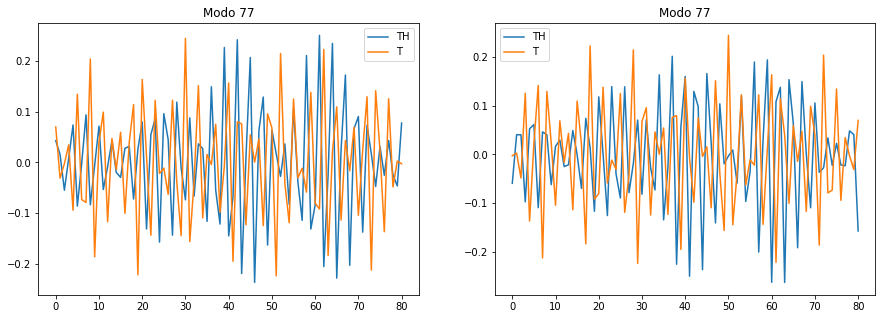

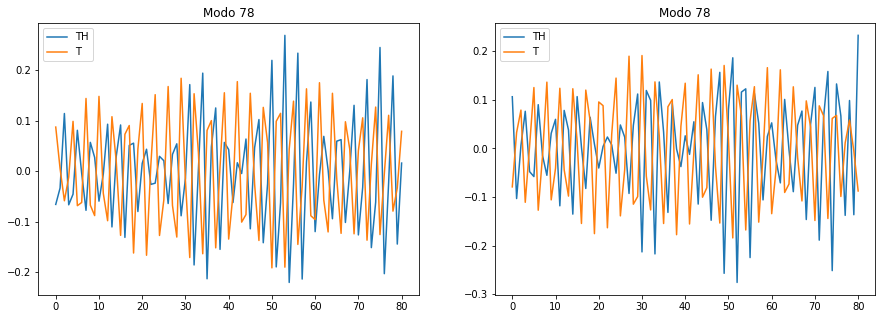

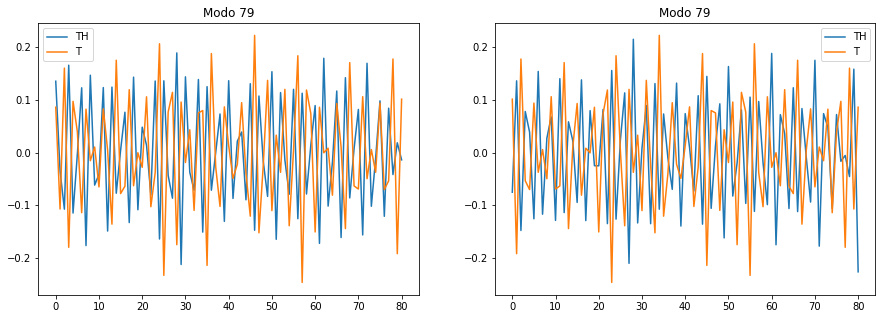

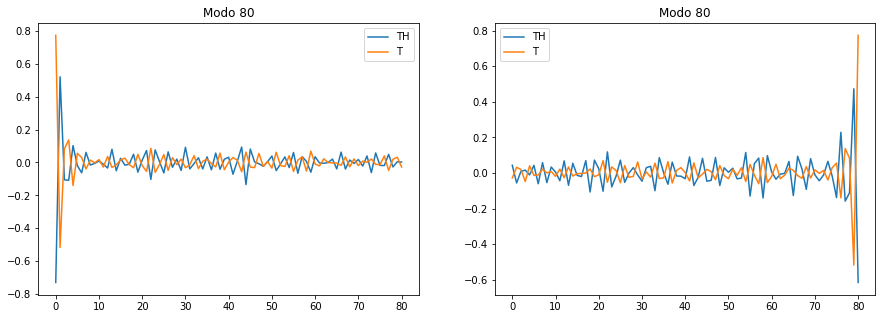

In [159]:
L=81

T_plus_H=Covariance_matrix_from_sub_sample(F_plus[0,:],F_minous[0,:],L)
T=Toeplitz_matrix(F_plus[0,:],L)
O_1_TH,S_T_H,O_2_TH=np.linalg.svd(T_plus_H)
O_1_T,S_T,O_2_T=np.linalg.svd(T)
for i in range(O_1_T.shape[0]):
    plt.figure(figsize=(15,5))
    plt.subplot(1,2,1)
    plt.title("Modo {}".format(i))
    plt.plot(O_1_TH[:,i],label="TH")
    plt.plot(O_1_T[:,i],label="T")
    plt.legend()
    plt.subplot(1,2,2)
    plt.title("Modo {}".format(i))
    plt.plot(O_2_TH[i,:],label="TH")
    plt.plot(O_2_T[i,:],label="T")
    plt.legend()
    plt.show()
       

    #plt.plot(res)
    #plt.show()
    

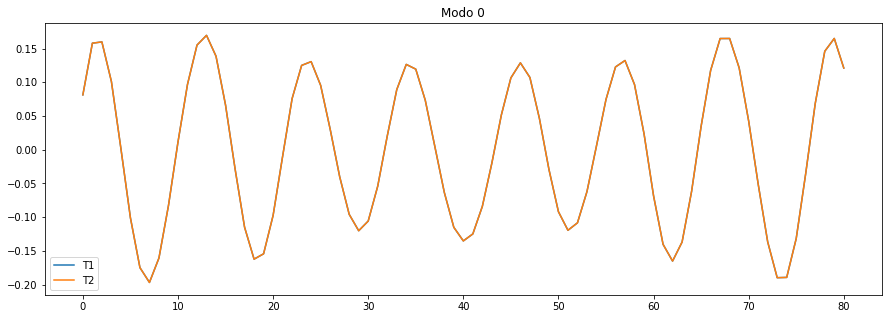

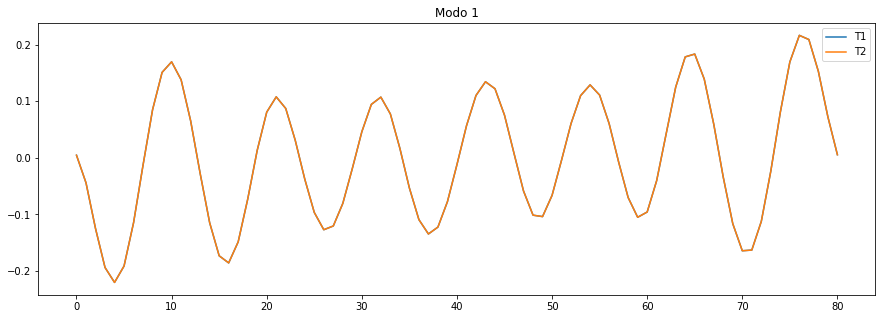

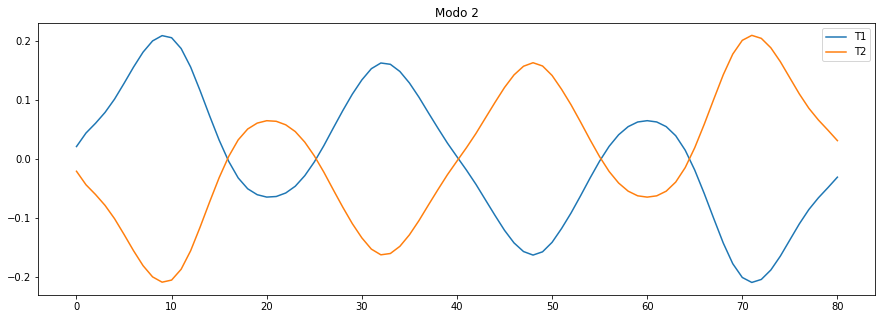

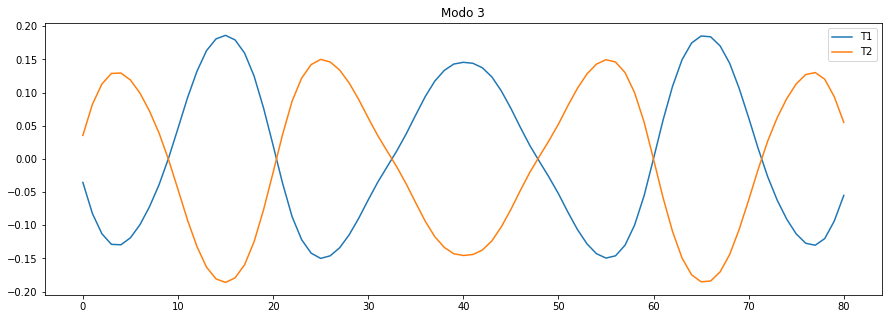

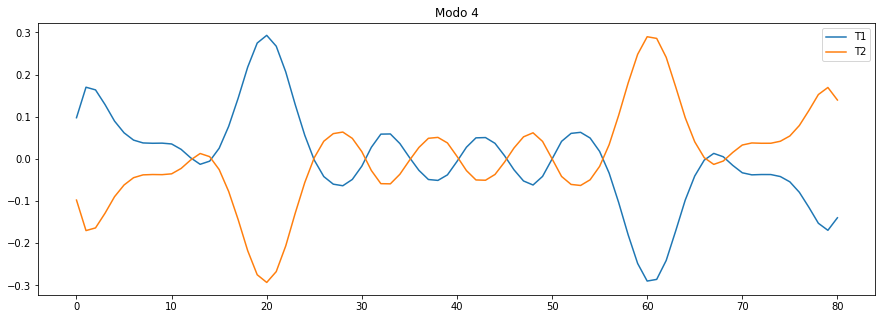

...

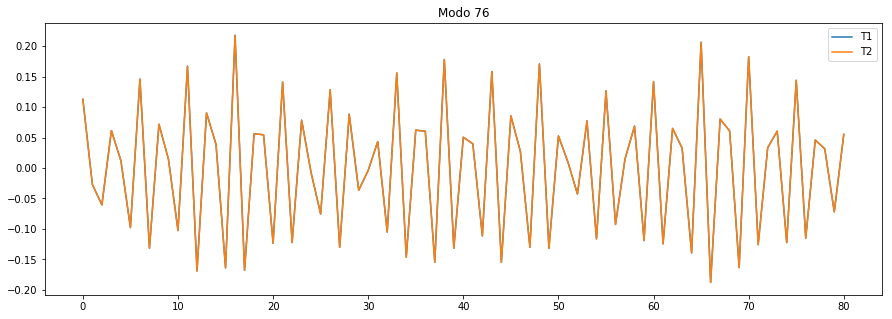

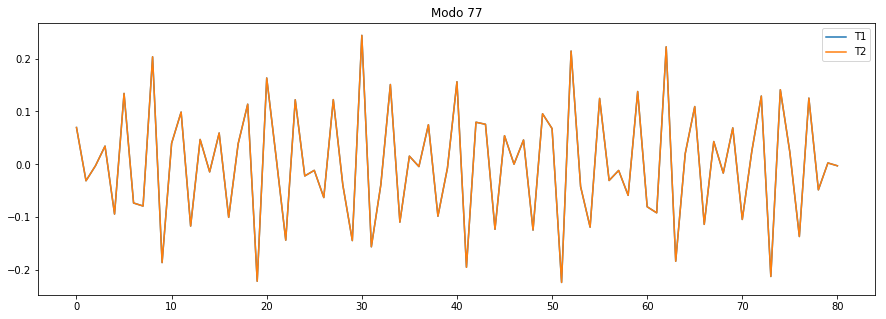

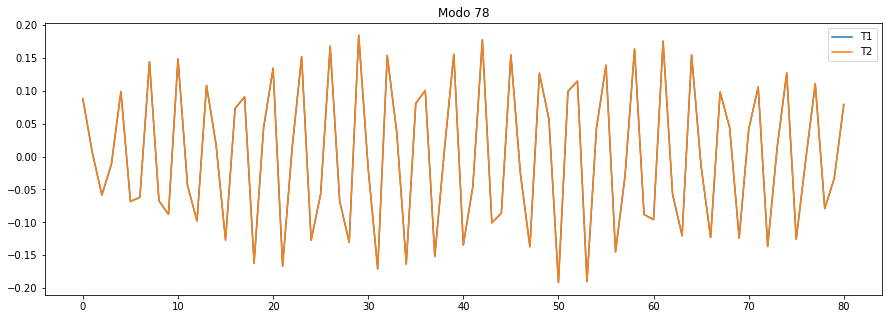

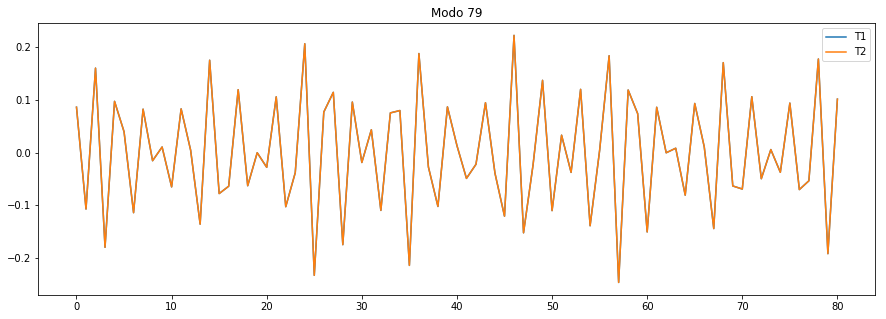

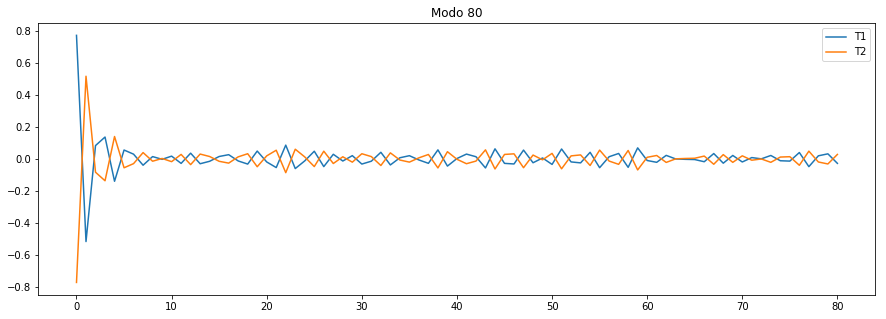

In [162]:
for i in range(O_1_T.shape[0]):
    plt.figure(figsize=(15,5))
    plt.title("Modo {}".format(i))
    plt.plot(O_1_T[:,i],label="T1")
    plt.title("Modo {}".format(i))
    plt.plot((-1)**(i+1)*O_2_T[i,:][::-1],label="T2")
    plt.legend()
    plt.show()

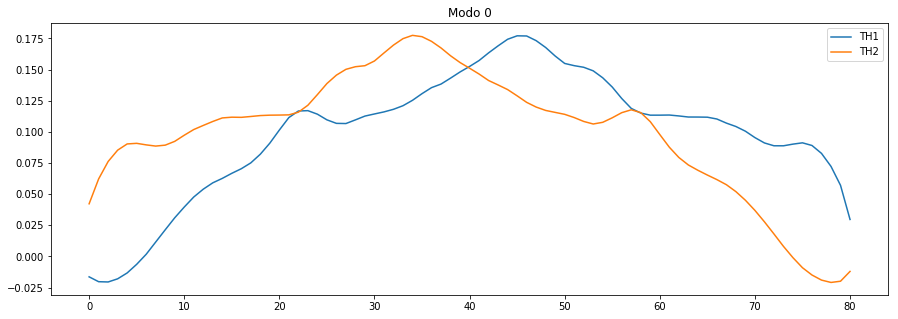

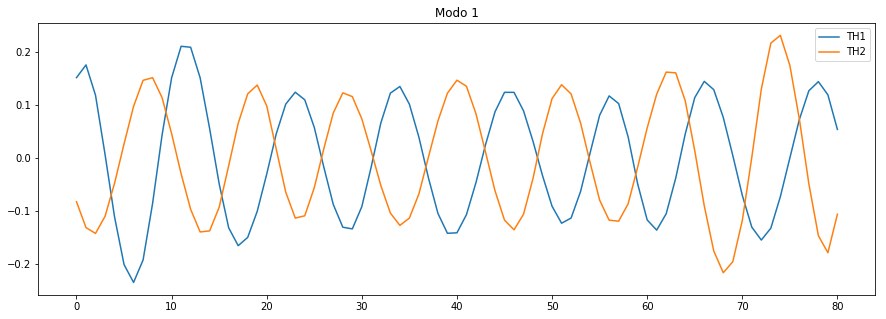

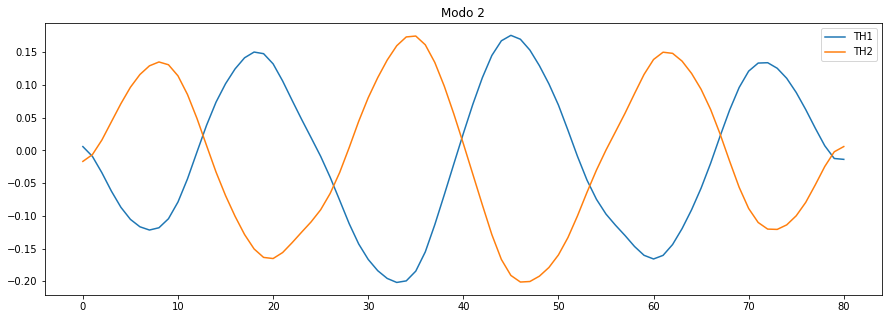

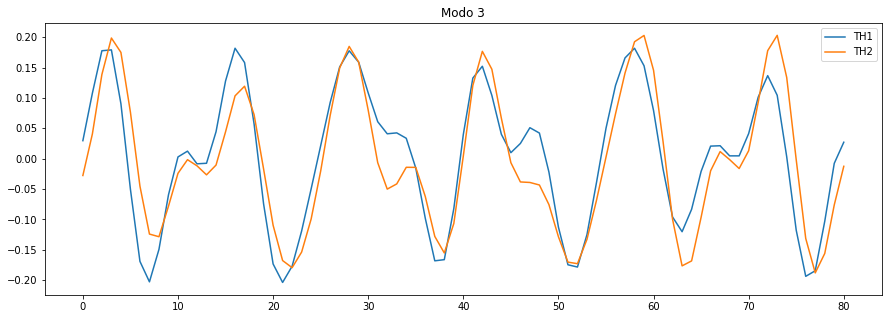

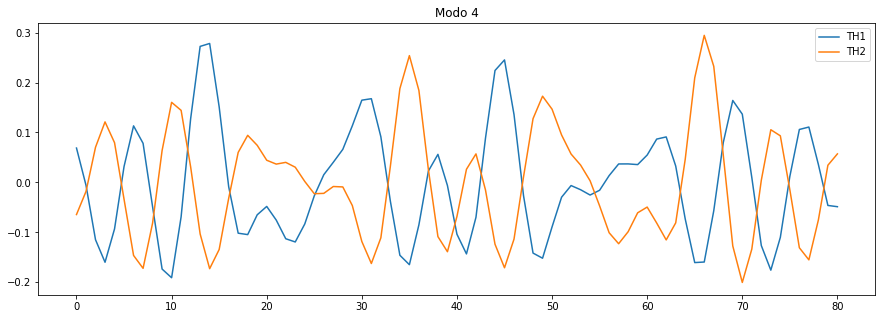

...

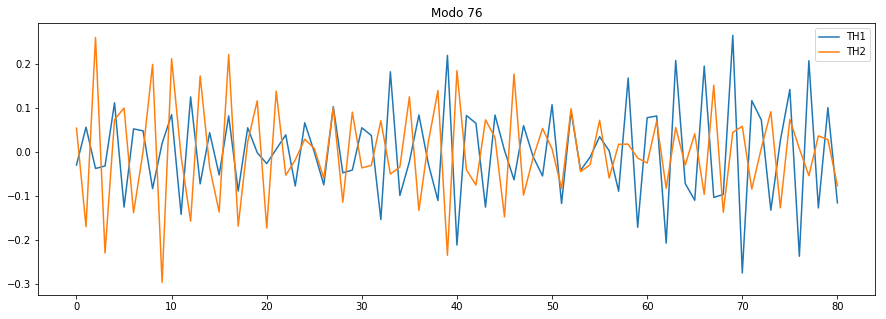

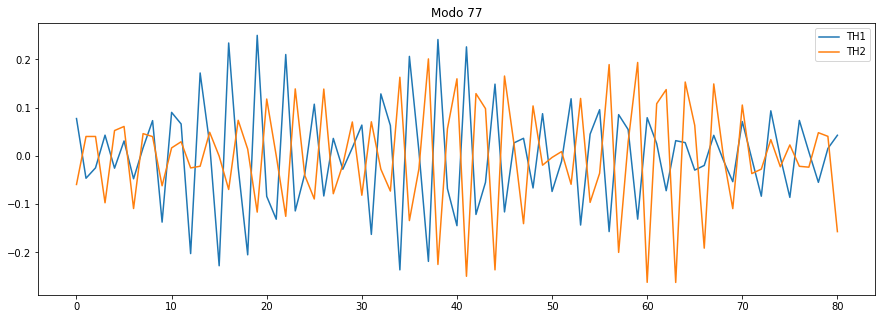

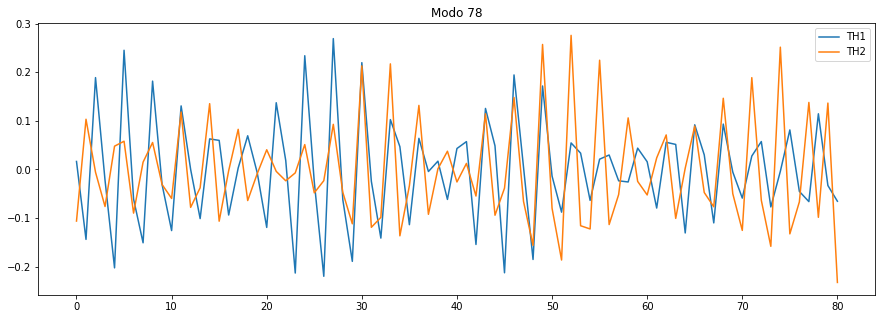

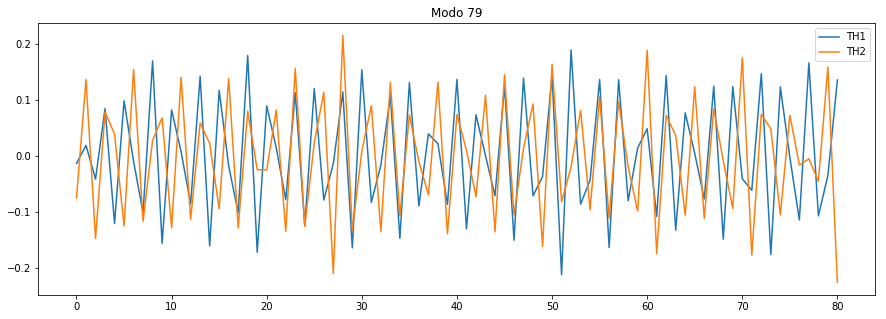

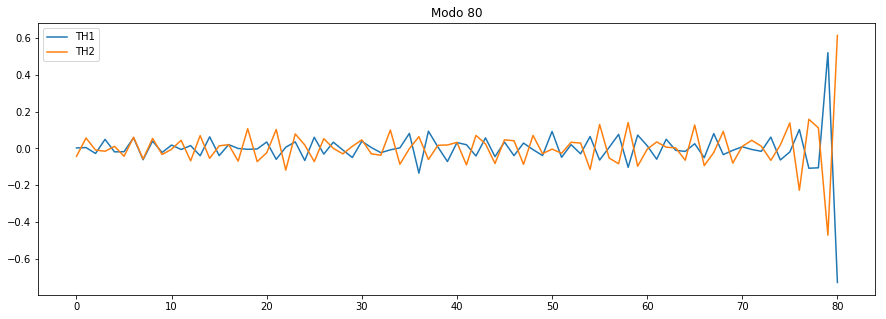

In [164]:
for i in range(O_1_T.shape[0]):
    plt.figure(figsize=(15,5))
    plt.title("Modo {}".format(i+1))
    plt.plot(O_1_TH[:,i][::-1],label="TH1")
    plt.title("Modo {}".format(i))
    plt.plot((-1)**(i+1)*O_2_TH[i,:],label="TH2")
    plt.legend()
    plt.show()

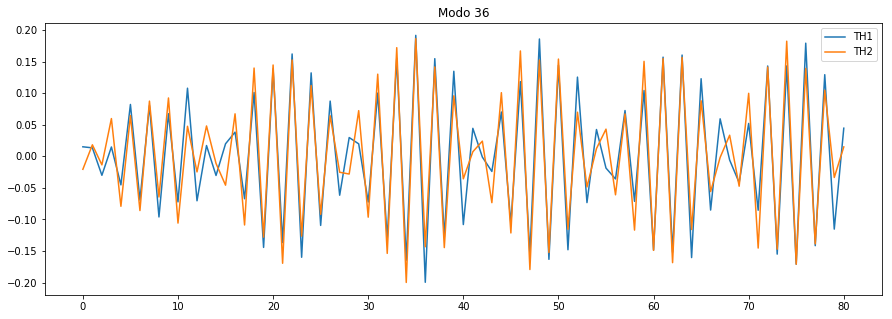

In [170]:
num=36
plt.figure(figsize=(15,5))
plt.title("Modo {}".format(num))
plt.plot(O_1_TH[:,num],label="TH1")
plt.plot(O_2_TH[num,:],label="TH2")
plt.legend()
plt.show()

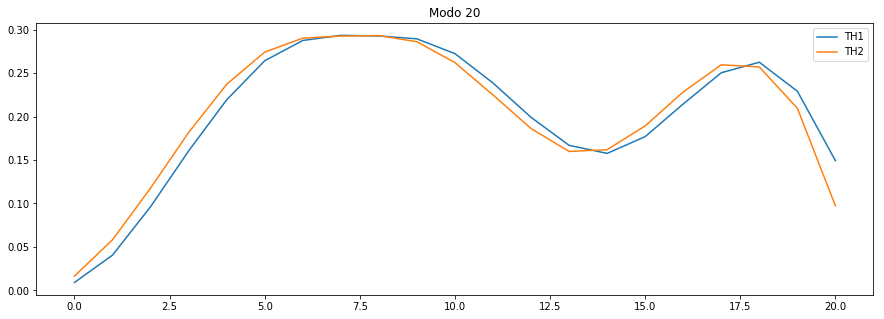

In [85]:
num=1
plt.figure(figsize=(15,5))
plt.title("Modo {}".format(num))
plt.plot(O_1_TH[:,num],label="TH1")
plt.title("Modo {}".format(i))
plt.plot(-1*O_2_TH[num,:],label="TH2")
plt.legend()
plt.show()

In [246]:
def function(num,shift,reverse,negative):
    plt.figure(figsize=(15,5))
    if negative=="Yes":
        number=-1
    else:
        number=1
    if reverse:
        plt.plot(np.roll(O_1_TH[:,int(num)],int(shift)),label="TH")
        plt.plot((number)*O_1_T[:,int(num)][::-1],label="T")
    else:
        plt.plot(np.roll(O_1_TH[:,int(num)],int(shift)),label="TH")
        plt.plot((number)*O_1_T[:,int(num)],label="T")
    plt.legend()
    plt.show()

In [242]:
import ipywidgets as widgets

In [247]:
a = widgets.FloatText(value=0)
b = widgets.FloatText()
c=widgets.Checkbox(value=False,description='Reverse',disabled=False)
d=widgets.ToggleButtons(
    value="Yes",
    options=['Yes', 'No'],
    description='Negative:',
    disabled=False,
    button_style='', # 'success', 'info', 'warning', 'danger' or ''
    tooltips=['multiply by -1', 'Do not multiply by -1'],
    #icons=['check'] * 3
)
interactive_plot = interactive(function, num=a, shift=b,reverse=c,negative=d)
output = interactive_plot.children[-1]
output.layout.height = '350px'
interactive_plot

interactive(children=(FloatText(value=0.0, description='num'), FloatText(value=0.0, description='shift'), Chec…

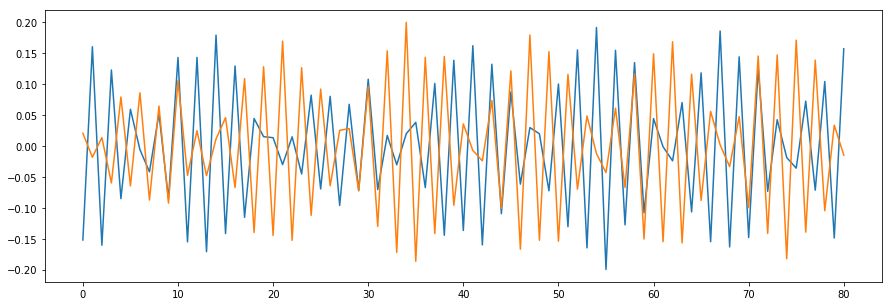

In [173]:
for i in range(20):
    clear_output(wait=True)
    plt.figure(figsize=(15,5))
    #plt.title("Modo {}".format(num))
    plt.plot(np.roll(O_1_TH[:,num],i),label="TH1")
    plt.plot(-1*O_2_TH[num,:],label="TH2")
    plt.show()

In [ ]:
rango=range(3,501,5)
total=[]
for L in rango:
    print(L,end="\r")
    res=[]
    for i in range(len(Data)):
        T_plus_H=Covariance_matrix_from_sub_sample(F_plus[i,:],F_minous[i,:],L)
        T=Toeplitz_matrix(F_plus[i,:],L)
        W_T_H=np.linalg.svd(T_plus_H,compute_uv=False)
        W_T=np.linalg.svd(T,compute_uv=False)
        result=np.sum(np.square((np.array(sorted(W_T_H))-np.array(sorted(W_T)))))/L
        res.append(result)
    total.append(np.mean(res))

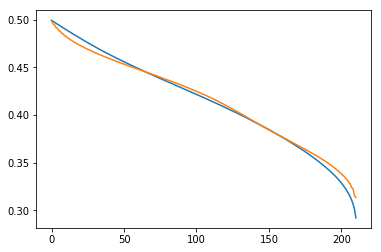

In [277]:
L=211
W_T_H_avg=np.zeros(L)
W_T_avg=np.zeros(L)
for i in range(len(Data)):
    T_plus_H=Covariance_matrix_from_sub_sample(F_plus[i,:],F_minous[i,:],L)
    T=Toeplitz_matrix(F_plus[i,:],L)
    W_T_H=np.linalg.svd(T_plus_H,compute_uv=False)
    W_T=np.linalg.svd(T,compute_uv=False)
    W_T_H_avg+=W_T_H
    W_T_avg+=W_T
    if i % 100 ==0:
        clear_output(wait=True)
        plt.plot(sorted(-W_T_H_avg/(i+1)+0.5,reverse=True))
        plt.plot(sorted(-W_T_avg/(i+1)+0.5,reverse=True))
        #n=np.arange(-(L-1)/2,(L-1)/2 +1)
        #plt.plot(sorted(Fermi_dirac(0.40824,0,n,Gamma=Gamma,Lambda=Lambda,N=L),reverse=True))
        plt.show()

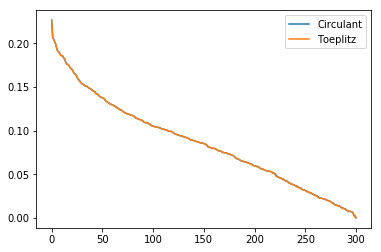

In [272]:
L=301
New_cov_matrix=Covariance_matrix_from_sub_sample(Data[1,:,0],Data[1,:,1],L=L)
S_2 = np.linalg.svd(New_cov_matrix.real,compute_uv=False)
M_corner=np.zeros((L,L))
M_corner[0,L-1],M_corner[L-1,0]=New_cov_matrix[1,0].real, New_cov_matrix[0,1].real
S_1 = np.linalg.svd(New_cov_matrix.real+M_corner,compute_uv=False)
plt.plot(S_1,label="Circulant")
plt.plot(S_2,label="Toeplitz")
plt.legend()
plt.show()

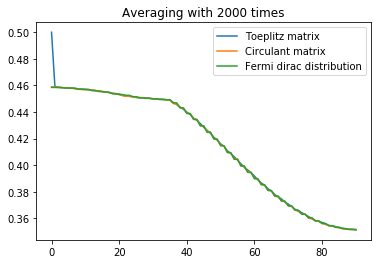

In [279]:
L=91
M=Covariance_matrix_from_sub_sample(Data[0,:,0],Data[0,:,1],L=L)
for i in range(1,2000):
    #print(i)
    M+=Covariance_matrix_from_sub_sample(Data[i,:,0],Data[i,:,1],L=L)
    S=np.linalg.svd(M,compute_uv=False)
    M_corner=np.zeros((L,L))
    M_corner[0,L-1],M_corner[L-1,0]=M[1,0].real, M[0,1].real
    S_circulant=np.linalg.svd(M+M_corner,compute_uv=False)
    if (i+1)%100==0:
        clear_output(wait=True)
        plt.plot(sorted(-S/(i+1)+0.5,reverse=True),label="Toeplitz matrix")
        plt.plot(sorted(-S_circulant/(i+1)+0.5,reverse=True),label="Circulant matrix")
        n=np.arange(-(L-1)/2,(L-1)/2 +1)
        f=Fermi_dirac(beta=0.40824,mu=0,n=n,Gamma=Gamma,Lambda=Lambda,N=L)
        plt.plot(sorted(f,reverse=True),label="Fermi dirac distribution")
        #plt.plot(S/(i+1))
        plt.title("Averaging with {} times".format(i+1))
        plt.legend()
        plt.show()

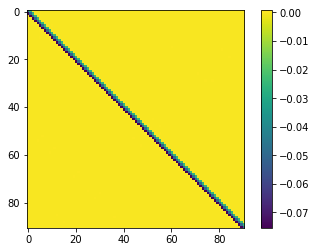

In [283]:
plt.imshow(M/2000)
plt.colorbar()

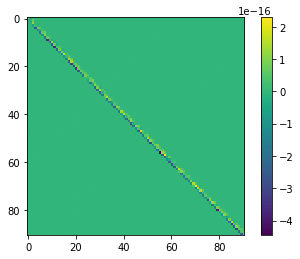

In [287]:
plt.imshow(Covariance_matrix_from_sub_sample(F_plus_avg,F_minous_avg,L=L)-M/2000)
plt.colorbar()

In [309]:
total=[]
for L in range(1201,2200,2):
    M=Covariance_matrix_from_sub_sample(Data[0,:,0],Data[0,:,1],L=L)
    for i in range(1,2000):
        M+=Covariance_matrix_from_sub_sample(Data[i,:,0],Data[i,:,1],L=L)
    fluctuations=np.sum(np.square(Covariance_matrix_from_sub_sample(F_plus_avg,F_minous_avg,L=L)-M/2000))
    total.append(fluctuations)
    print(L,fluctuations)

1201 6.698491573992158e-29
1203 6.703263895793972e-29
1205 6.70953820830012e-29
1207 6.71804253316099e-29
1209 6.729432498884417e-29
1211 6.737594501483951e-29
1213 6.757741632697969e-29
1215 6.778494659142955e-29
1217 6.792689581462808e-29
1219 6.810132069772822e-29
1221 6.829171461430715e-29
1223 6.836252451928208e-29
1225 6.851349999503952e-29
1227 6.858217949183216e-29
1229 6.870867488662047e-29
1231 6.89583923775646e-29
1233 6.908783586392418e-29
1235 6.918199512511762e-29
1237 6.926339659604746e-29
1239 6.932014584285231e-29
1241 6.938613151042303e-29
1243 6.951003603760344e-29
1245 6.971272251011088e-29
1247 6.983849480955995e-29
1249 6.999230087815782e-29
1251 7.015598135010682e-29
1253 7.031190435231416e-29
1255 7.040618868994814e-29
1257 7.055593935691797e-29
1259 7.075745687616989e-29
1261 7.079310477524831e-29
1263 7.11068097620925e-29
1265 7.138872559618416e-29
1267 7.162048503733783e-29
1269 7.172054707291898e-29
1271 7.182191950389831e-29
1273 7.197808577135186e-29
1275 

1811 1.0167202762092181e-28
1813 1.0178135312711663e-28
1815 1.0188062237481813e-28
1817 1.0200906271797717e-28
1819 1.021254235469231e-28
1821 1.0219292169808576e-28
1823 1.0230616400995922e-28
1825 1.024724634309344e-28
1827 1.026059285226413e-28
1829 1.0269461362662058e-28
1831 1.0294034827276631e-28
1833 1.0303250169914002e-28
1835 1.030957202611559e-28
1837 1.0323269958747364e-28
1839 1.033433882221043e-28
1841 1.0342268606140637e-28
1843 1.034586606451192e-28
1845 1.03721316963642e-28
1847 1.0386574802529204e-28
1849 1.0402998065725377e-28
1851 1.040704705296016e-28
1853 1.0419912121063841e-28
1855 1.0425900570310757e-28
1857 1.0436754328602762e-28
1859 1.0452421427309996e-28
1861 1.0464296362373052e-28
1863 1.0474253303551378e-28
1865 1.047832315109055e-28
1867 1.049376531205556e-28
1869 1.0505735146268324e-28
1871 1.0526790315923119e-28
1873 1.0533637059265994e-28
1875 1.0545754963348993e-28
1877 1.0554586483293624e-28
1879 1.0572048735386303e-28
1881 1.0581508608435548e-28
188